In [122]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression,LogisticRegression
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score,mean_absolute_error
import seaborn as sns 
import matplotlib.pyplot as plt

In [123]:
df=pd.read_csv("international_matches.csv")
df=df.drop(['city','country','date','home_team_continent','away_team_continent','home_team_goalkeeper_score','away_team_goalkeeper_score','home_team_mean_defense_score','home_team_mean_offense_score','home_team_mean_midfield_score','away_team_mean_defense_score','away_team_mean_offense_score','away_team_mean_midfield_score'],axis=1)



In [124]:
df['away_team'].nunique()

211

In [125]:
df['home_team'].nunique()

211

In [126]:
from sklearn.preprocessing import LabelEncoder


In [127]:
le = LabelEncoder()
ids = le.fit_transform(df['home_team'])
mapping = dict(zip(le.classes_, range(len(le.classes_))))

In [128]:
le = LabelEncoder()
ids = le.fit_transform(df['tournament'])
mapping_tournament = dict(zip(le.classes_, range(len(le.classes_))))

In [129]:
mapping

{'Afghanistan': 0,
 'Albania': 1,
 'Algeria': 2,
 'American Samoa': 3,
 'Andorra': 4,
 'Angola': 5,
 'Anguilla': 6,
 'Antigua and Barbuda': 7,
 'Argentina': 8,
 'Armenia': 9,
 'Aruba': 10,
 'Australia': 11,
 'Austria': 12,
 'Azerbaijan': 13,
 'Bahamas': 14,
 'Bahrain': 15,
 'Bangladesh': 16,
 'Barbados': 17,
 'Belarus': 18,
 'Belgium': 19,
 'Belize': 20,
 'Benin': 21,
 'Bermuda': 22,
 'Bhutan': 23,
 'Bolivia': 24,
 'Bosnia and Herzegovina': 25,
 'Botswana': 26,
 'Brazil': 27,
 'British Virgin Islands': 28,
 'Brunei Darussalam': 29,
 'Bulgaria': 30,
 'Burkina Faso': 31,
 'Burundi': 32,
 'Cabo Verde': 33,
 'Cambodia': 34,
 'Cameroon': 35,
 'Canada': 36,
 'Cayman Islands': 37,
 'Central African Republic': 38,
 'Chad': 39,
 'Chile': 40,
 'China PR': 41,
 'Chinese Taipei': 42,
 'Colombia': 43,
 'Comoros': 44,
 'Congo': 45,
 'Congo DR': 46,
 'Cook Islands': 47,
 'Costa Rica': 48,
 'Croatia': 49,
 'Cuba': 50,
 'Curaçao': 51,
 'Cyprus': 52,
 'Czech Republic': 53,
 "Côte d'Ivoire": 54,
 'Denmar

In [130]:
df['tournament'].nunique()

82

In [131]:
df[['home_team']] = df[['home_team']].apply(LabelEncoder().fit_transform)
df[['tournament']]=df[['tournament']].apply(LabelEncoder().fit_transform)
df[['neutral_location']]=df[['neutral_location']].apply(LabelEncoder().fit_transform)
df[['shoot_out']]=df[['shoot_out']].apply(LabelEncoder().fit_transform)
df=pd.get_dummies(df,prefix=[''],columns=['home_team_result'])
df[['_Win']]=df[['_Win']].apply(LabelEncoder().fit_transform)
df[['_Lose']]=df[['_Lose']].apply(LabelEncoder().fit_transform)
df[['_Draw']]=df[['_Draw']].apply(LabelEncoder().fit_transform)

In [132]:
df.head()

,home_team,away_team,home_team_fifa_rank,away_team_fifa_rank,home_team_total_fifa_points,away_team_total_fifa_points,home_team_score,away_team_score,tournament,neutral_location,shoot_out,_Draw,_Lose,_Win
0,24,Uruguay,59,22,0,0,3,1,37,0,0,0,0,1
1,27,Mexico,8,14,0,0,1,1,38,0,0,1,0,0
2,59,Venezuela,35,94,0,0,5,0,37,0,0,0,0,1
3,82,Sierra Leone,65,86,0,0,1,0,38,0,0,0,0,1
4,148,Argentina,67,5,0,0,1,3,37,0,0,0,1,0


In [133]:
df['away_team'][23]

'Bolivia'

In [134]:
for i in range(len(df)):
    df['away_team'][i] =mapping[df['away_team'][i]] 

C:\Users\USER\AppData\Local\Temp\ipykernel_18384\1546324333.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['away_team'][i] =mapping[df['away_team'][i]]
C:\Users\USER\AppData\Local\Temp\ipykernel_18384\1546324333.py:2: SettingWithCopy

In [135]:
df.iloc[0]

home_team                       24
away_team                      202
home_team_fifa_rank             59
away_team_fifa_rank             22
home_team_total_fifa_points      0
away_team_total_fifa_points      0
home_team_score                  3
away_team_score                  1
tournament                      37
neutral_location                 0
shoot_out                        0
_Draw                            0
_Lose                            0
_Win                             1
Name: 0, dtype: object

In [136]:
df.loc[0]

home_team                       24
away_team                      202
home_team_fifa_rank             59
away_team_fifa_rank             22
home_team_total_fifa_points      0
away_team_total_fifa_points      0
home_team_score                  3
away_team_score                  1
tournament                      37
neutral_location                 0
shoot_out                        0
_Draw                            0
_Lose                            0
_Win                             1
Name: 0, dtype: object

In [137]:
df.loc[24]

home_team                       43
away_team                      149
home_team_fifa_rank             19
away_team_fifa_rank             70
home_team_total_fifa_points      0
away_team_total_fifa_points      0
home_team_score                  4
away_team_score                  0
tournament                      37
neutral_location                 0
shoot_out                        0
_Draw                            0
_Lose                            0
_Win                             1
Name: 24, dtype: object

In [138]:
df.describe()

,home_team,home_team_fifa_rank,away_team_fifa_rank,home_team_total_fifa_points,away_team_total_fifa_points,home_team_score,away_team_score,tournament,neutral_location,shoot_out,_Draw,_Lose,_Win
count,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000,23921.000000
mean,107.479119,77.854688,80.797375,323.401488,315.453576,1.609214,1.068266,36.543999,0.249739,0.013879,0.225283,0.283057,0.491660
std,59.814624,52.355225,53.232902,500.825725,490.944273,1.630127,1.263944,18.086472,0.432871,0.116991,0.417777,0.450493,0.499941
min,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,59.000000,33.000000,36.000000,0.000000,0.000000,0.000000,0.000000,37.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,105.000000,71.000000,73.000000,0.000000,0.000000,1.000000,1.000000,38.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,157.000000,115.000000,119.000000,547.000000,523.000000,2.000000,2.000000,38.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,210.000000,211.000000,211.000000,2164.000000,2164.000000,31.000000,21.000000,81.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [144]:
X=df.drop(['_Win','_Lose','_Draw'],axis=1)
y=df[['_Win','_Lose','_Draw']]

In [145]:
y.head()

,_Win,_Lose,_Draw
0,1,0,0
1,0,0,1
2,1,0,0
3,1,0,0
4,0,1,0


In [147]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=101)
X_train=np.asarray(X_train).astype('float32')
X_test=np.asarray(X_test).astype('float32')
y_train=np.asarray(y_train).astype('float32')
y_test=np.asarray(y_test).astype('float32')




In [148]:
import tensorflow as tf


In [153]:
def train_model(X_train,y_train,num_nodes,dropout_prob,lr,batch_size,epochs):
# Create a model
  model = tf.keras.Sequential([
    tf.keras.layers.Dense(num_nodes, activation='relu',input_shape=(11,)),
    tf.keras.layers.Dropout(dropout_prob),
    tf.keras.layers.Dense(num_nodes, activation='relu'),
    tf.keras.layers.Dropout(dropout_prob),
    tf.keras.layers.Dense(3, activation='softmax')
  ])

  # Compile the model
  model.compile(optimizer=tf.keras.optimizers.Adam(lr),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

  # Train the model
  history=model.fit(X_train, y_train, epochs=epochs,batch_size=batch_size,validation_split=0.2,verbose=0)
  return model,history

16 nodes,dropout 0,lr 0.1,batch_size 8
1.0500906705856323


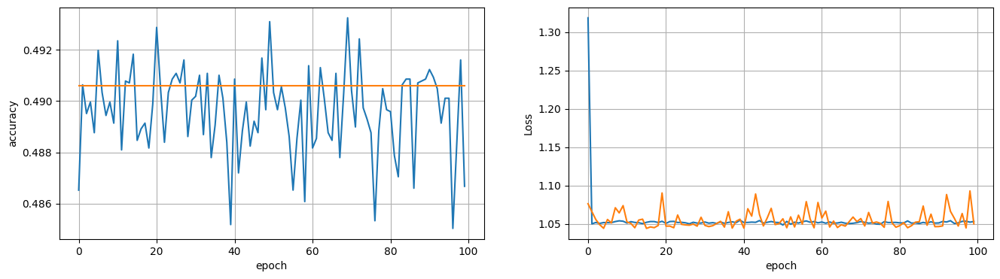

16 nodes,dropout 0,lr 0.1,batch_size 16
1.0453424453735352


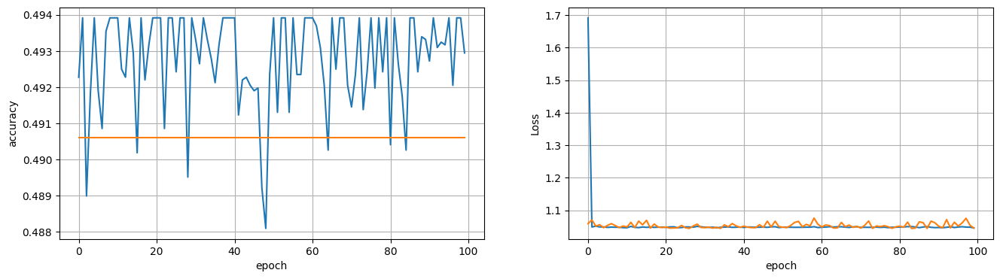

16 nodes,dropout 0,lr 0.1,batch_size 64
1.0483721494674683


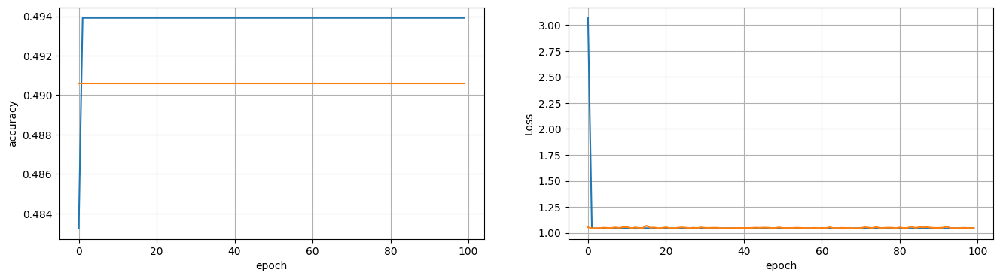

16 nodes,dropout 0,lr 0.005,batch_size 8
0.03771083801984787


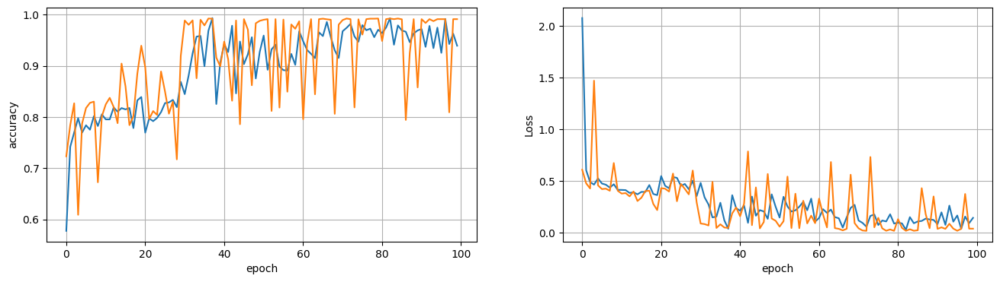

16 nodes,dropout 0,lr 0.005,batch_size 16
0.09123142808675766


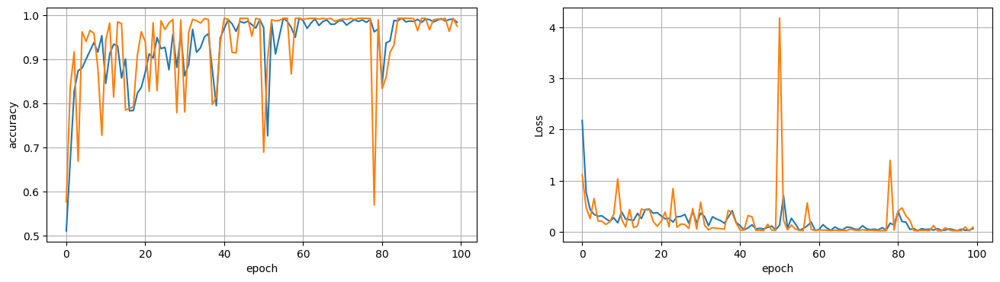

16 nodes,dropout 0,lr 0.005,batch_size 64
0.024638274684548378


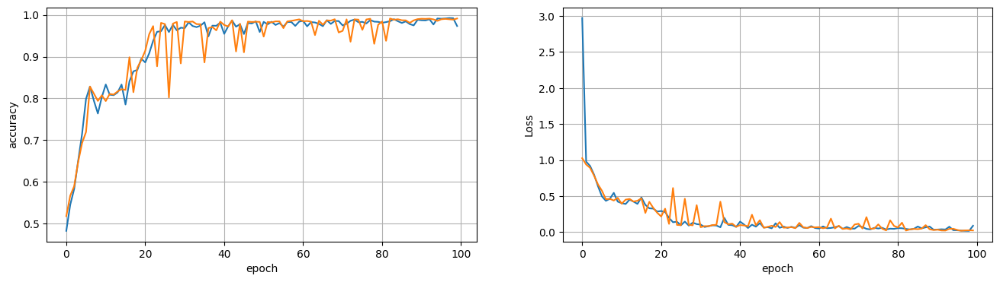

16 nodes,dropout 0,lr 0.001,batch_size 8
0.022291626781225204


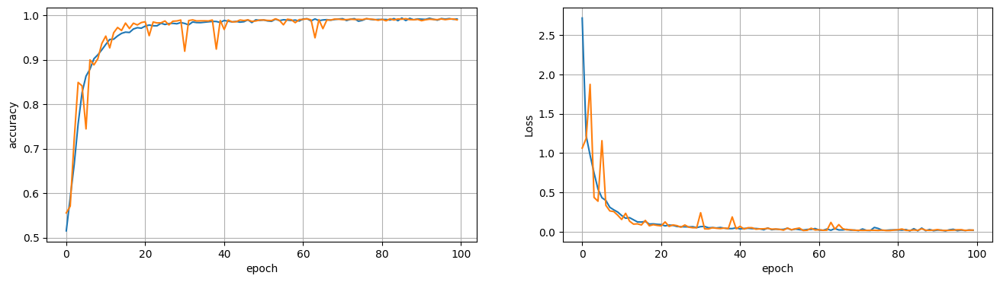

16 nodes,dropout 0,lr 0.001,batch_size 16
0.048811376094818115


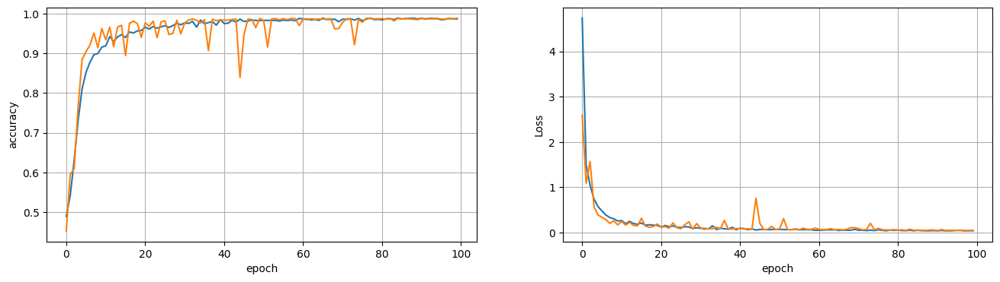

16 nodes,dropout 0,lr 0.001,batch_size 64
0.049655843526124954


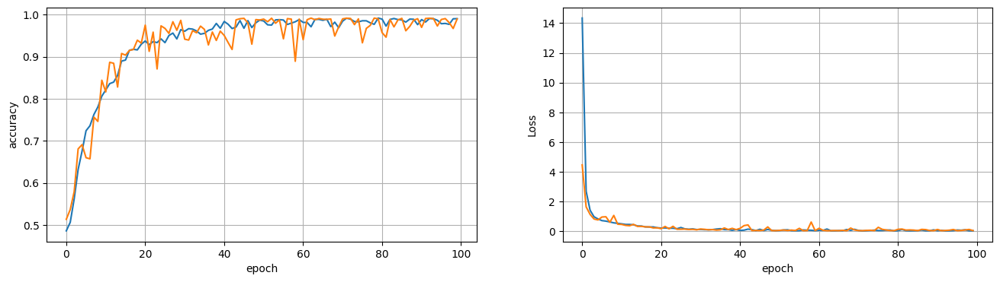

16 nodes,dropout 0.2,lr 0.1,batch_size 8
1.0798745155334473


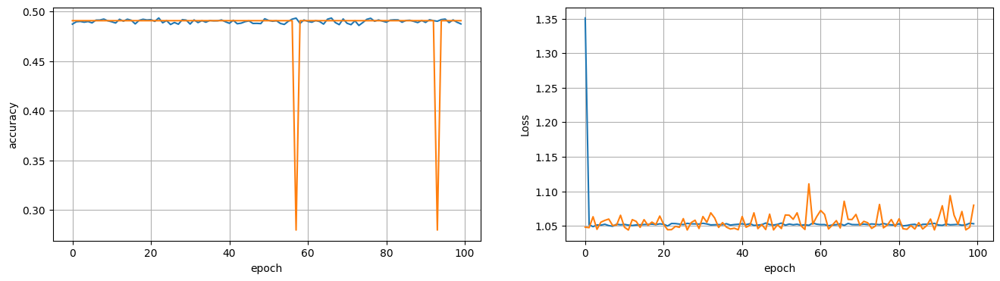

16 nodes,dropout 0.2,lr 0.1,batch_size 16
1.0597654581069946


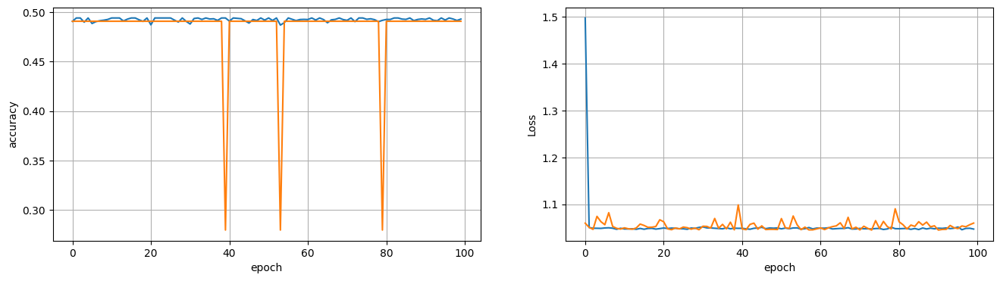

16 nodes,dropout 0.2,lr 0.1,batch_size 64
1.0468159914016724


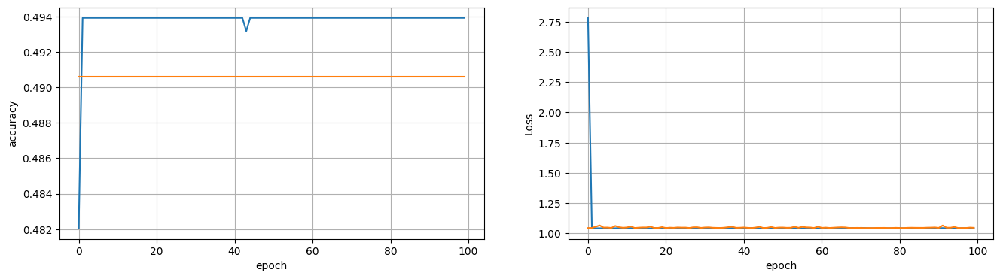

16 nodes,dropout 0.2,lr 0.005,batch_size 8
0.46941685676574707


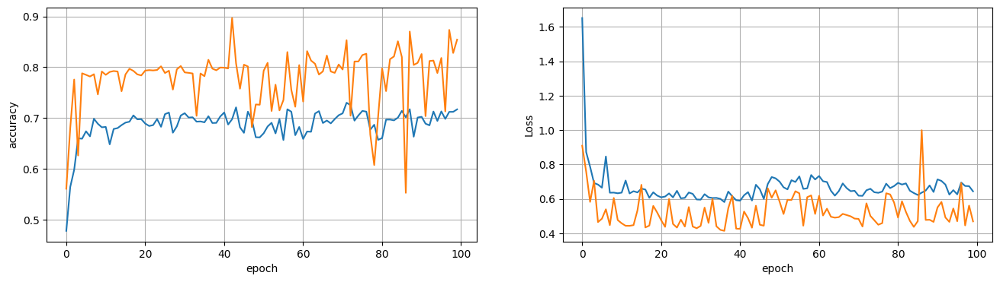

16 nodes,dropout 0.2,lr 0.005,batch_size 16
0.3020702600479126


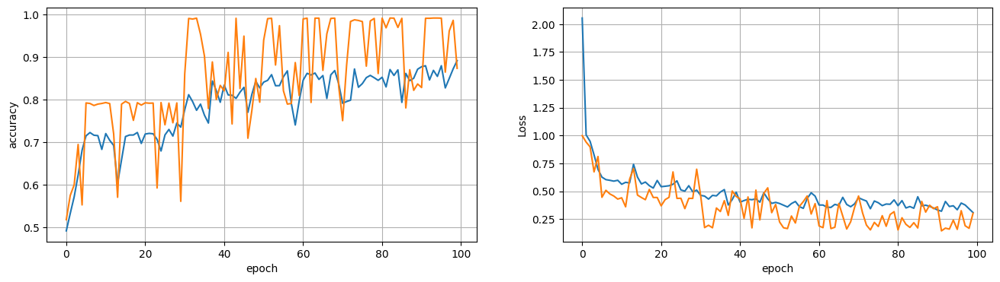

16 nodes,dropout 0.2,lr 0.005,batch_size 64
0.1072685569524765


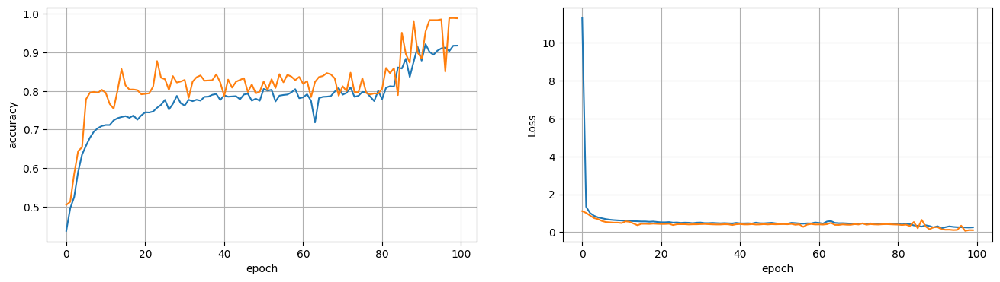

16 nodes,dropout 0.2,lr 0.001,batch_size 8
0.15747645497322083


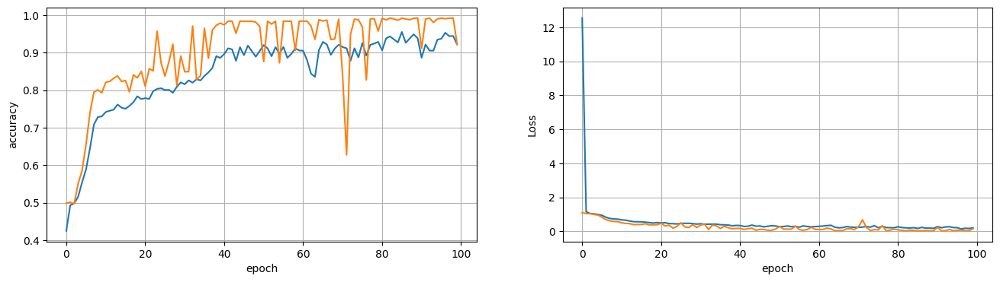

16 nodes,dropout 0.2,lr 0.001,batch_size 16
0.1184907853603363


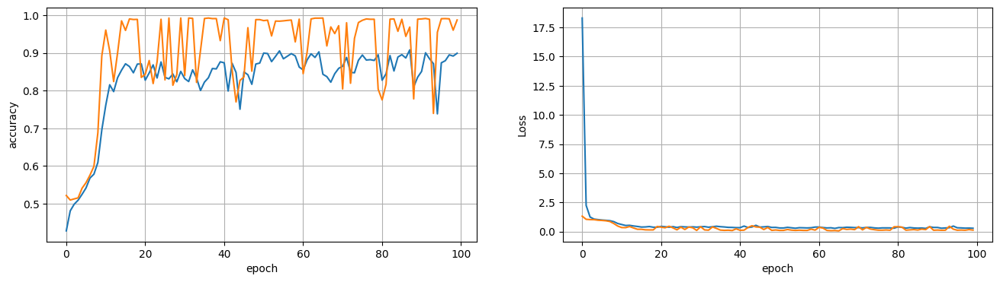

16 nodes,dropout 0.2,lr 0.001,batch_size 64
0.05240778252482414


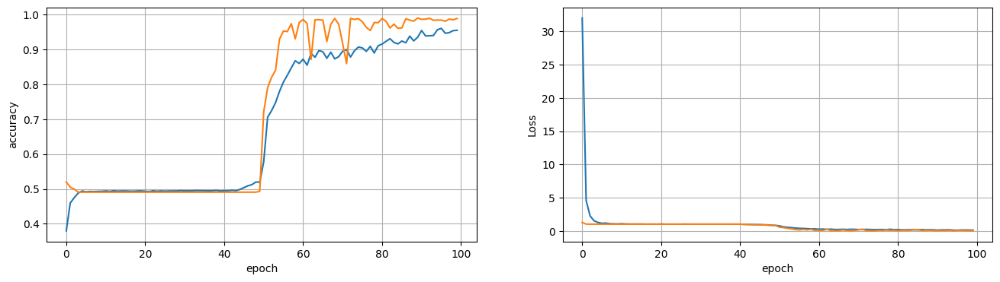

32 nodes,dropout 0,lr 0.1,batch_size 8
1.0585451126098633


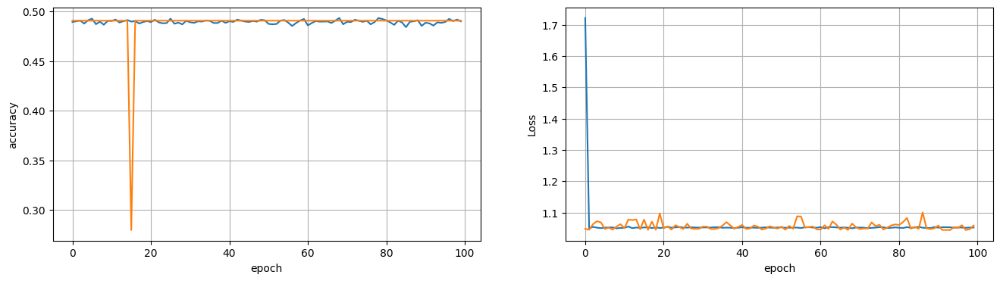

32 nodes,dropout 0,lr 0.1,batch_size 16
1.0490012168884277


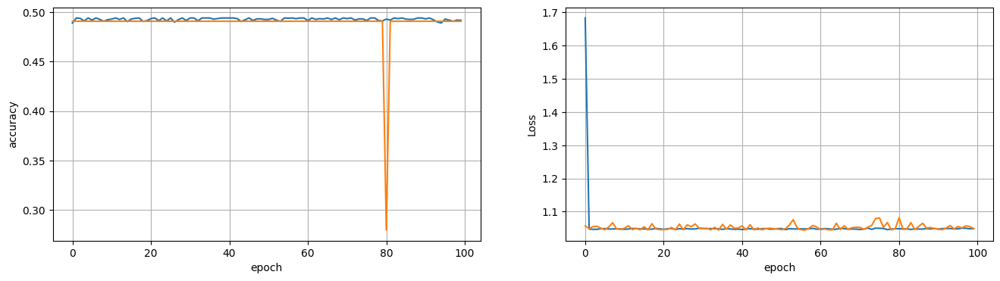

32 nodes,dropout 0,lr 0.1,batch_size 64
1.0451651811599731


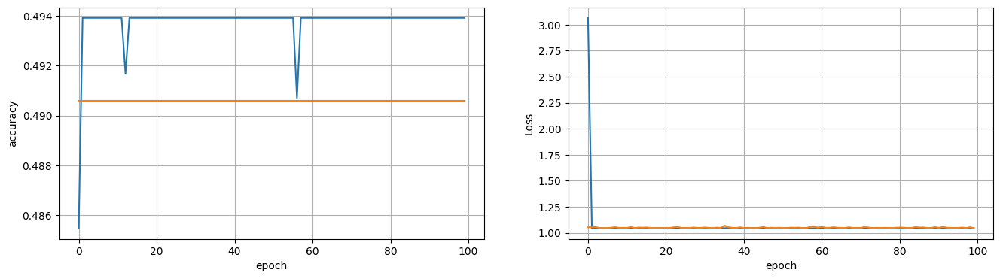

32 nodes,dropout 0,lr 0.005,batch_size 8
0.03174677863717079


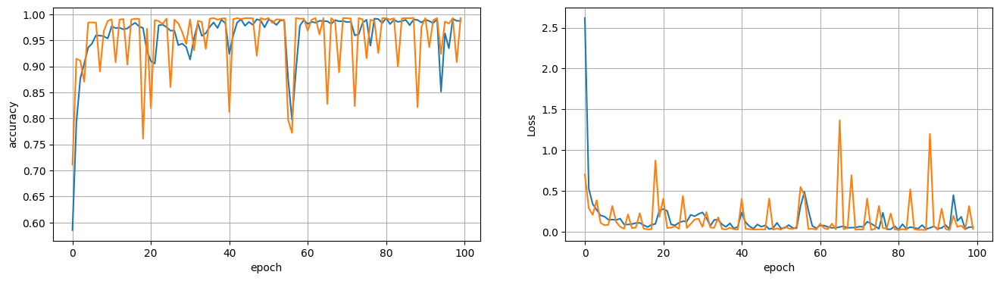

32 nodes,dropout 0,lr 0.005,batch_size 16
0.08663339912891388


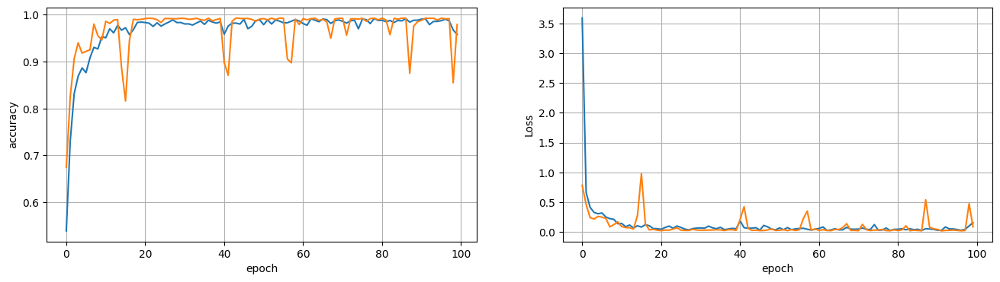

32 nodes,dropout 0,lr 0.005,batch_size 64
0.18171213567256927


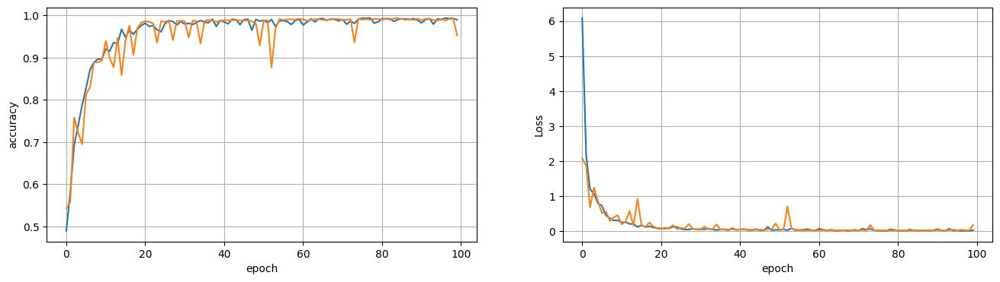

32 nodes,dropout 0,lr 0.001,batch_size 8
0.1462845504283905


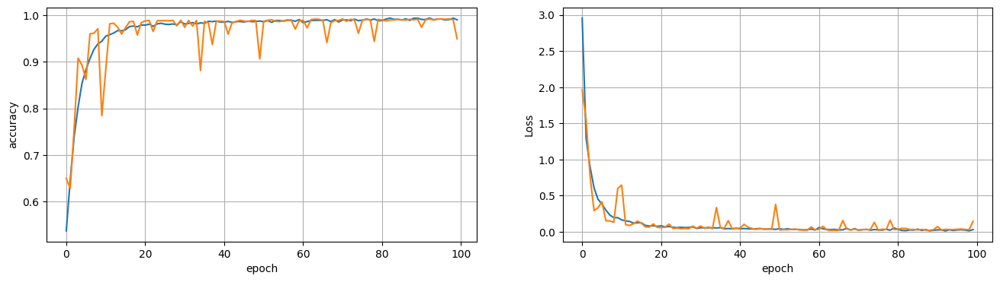

32 nodes,dropout 0,lr 0.001,batch_size 16
0.03998982533812523


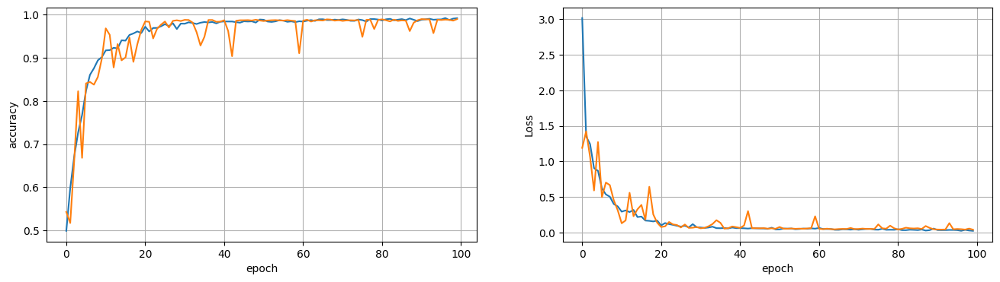

32 nodes,dropout 0,lr 0.001,batch_size 64
0.05486016348004341


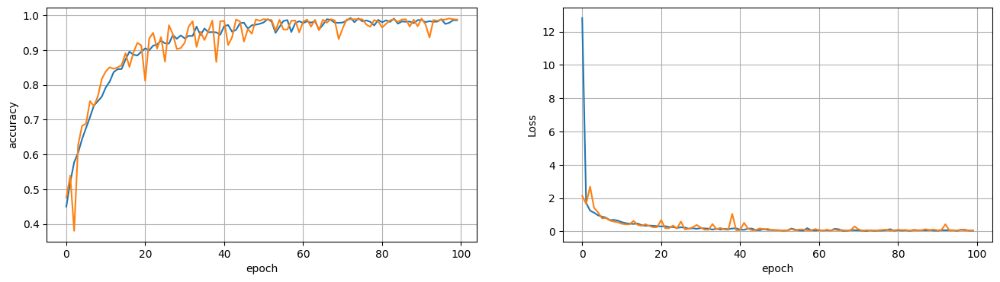

32 nodes,dropout 0.2,lr 0.1,batch_size 8
1.0439144372940063


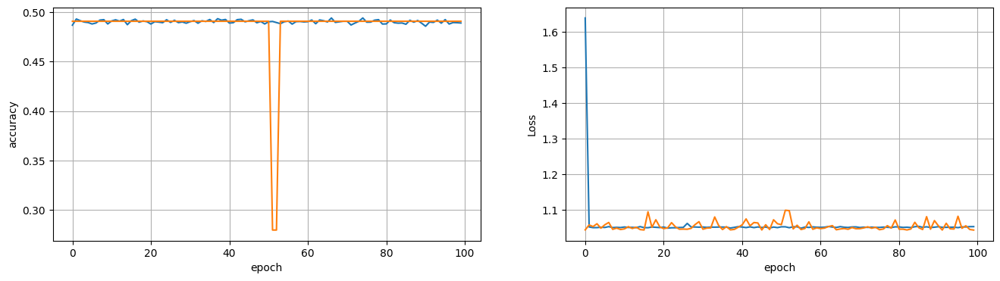

32 nodes,dropout 0.2,lr 0.1,batch_size 16
1.052066445350647


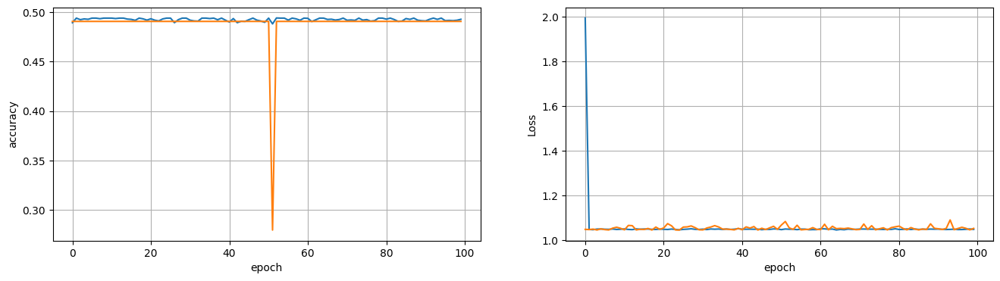

32 nodes,dropout 0.2,lr 0.1,batch_size 64
1.0520174503326416


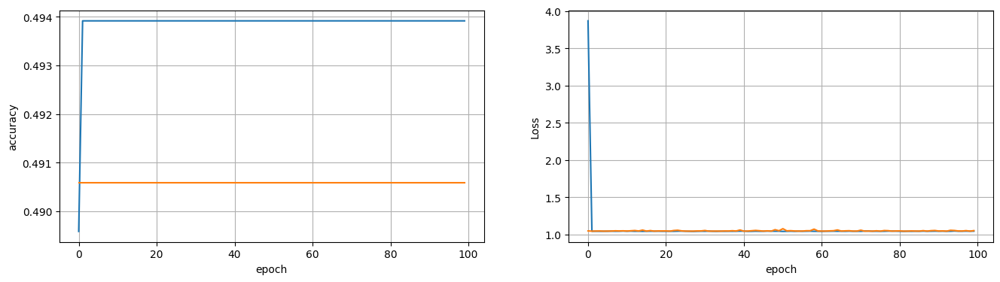

32 nodes,dropout 0.2,lr 0.005,batch_size 8
0.2525659501552582


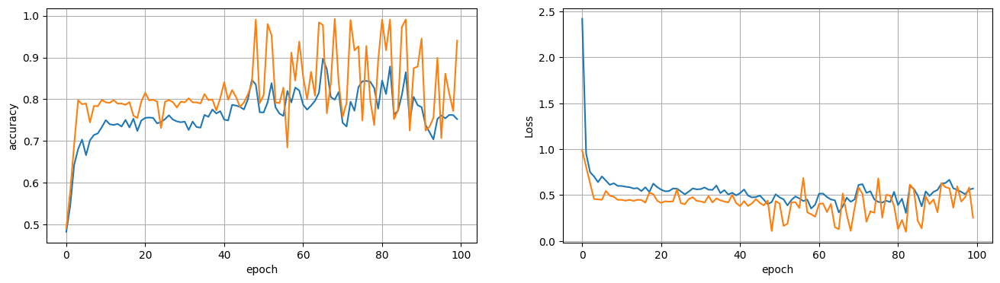

32 nodes,dropout 0.2,lr 0.005,batch_size 16
0.30990952253341675


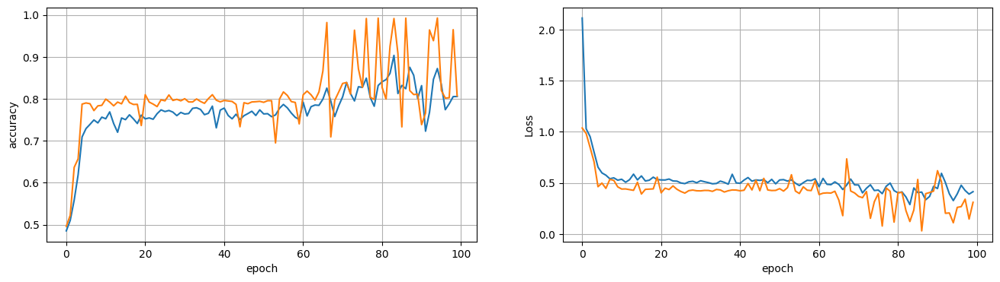

32 nodes,dropout 0.2,lr 0.005,batch_size 64
0.285677969455719


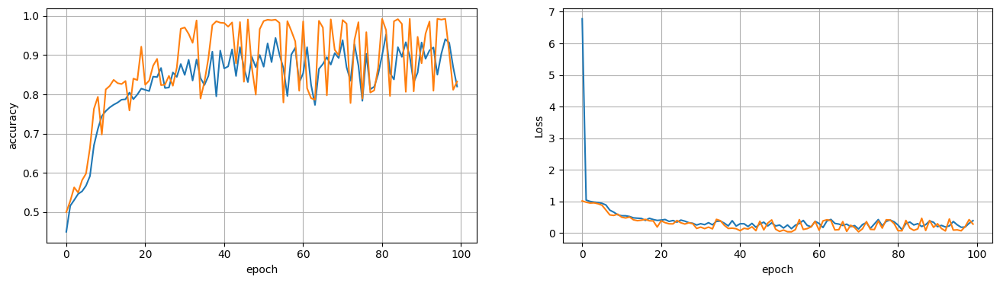

32 nodes,dropout 0.2,lr 0.001,batch_size 8
0.11184865981340408


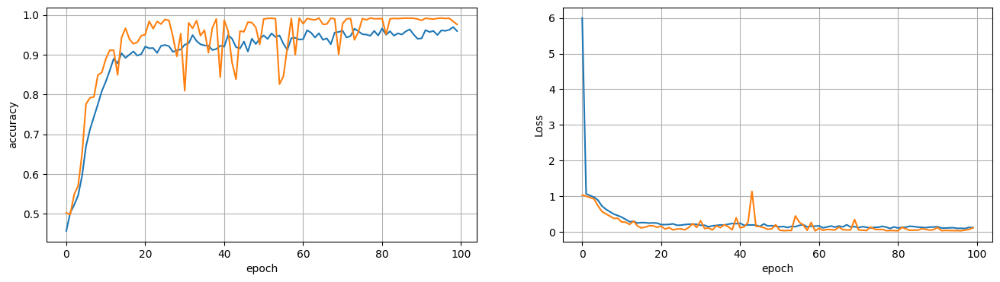

32 nodes,dropout 0.2,lr 0.001,batch_size 16
0.11260910332202911


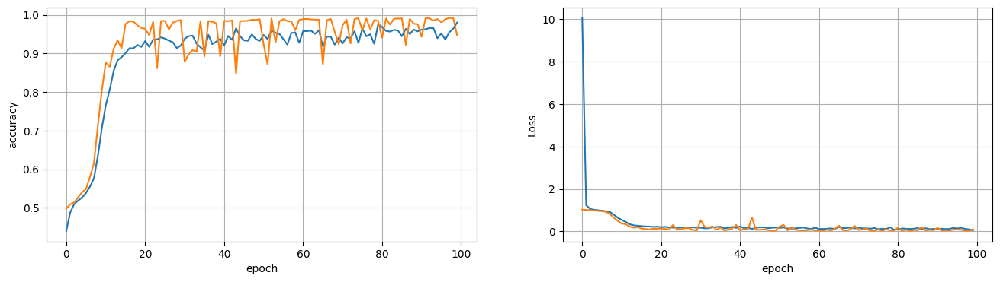

32 nodes,dropout 0.2,lr 0.001,batch_size 64
0.04655389115214348


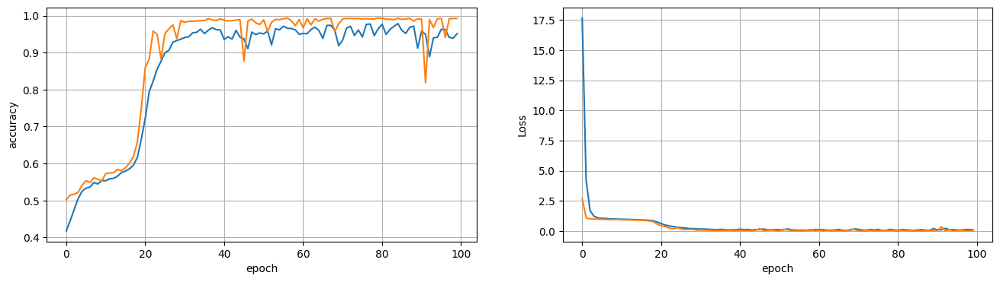

64 nodes,dropout 0,lr 0.1,batch_size 8
1.044954538345337


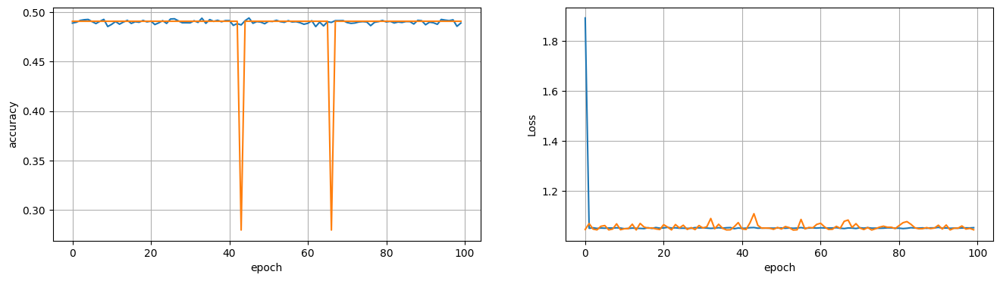

64 nodes,dropout 0,lr 0.1,batch_size 16
1.0511358976364136


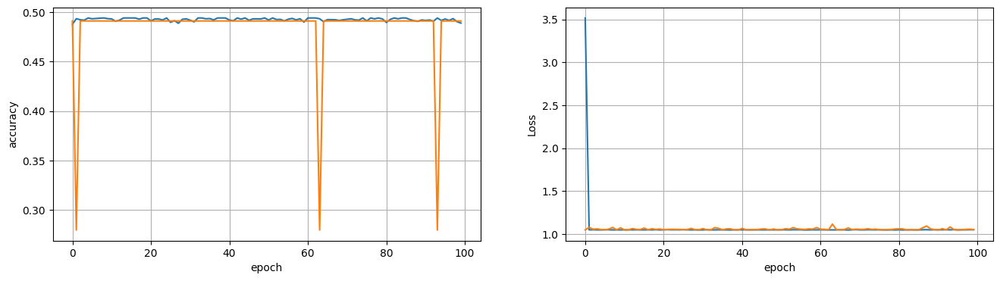

64 nodes,dropout 0,lr 0.1,batch_size 64
1.0512583255767822


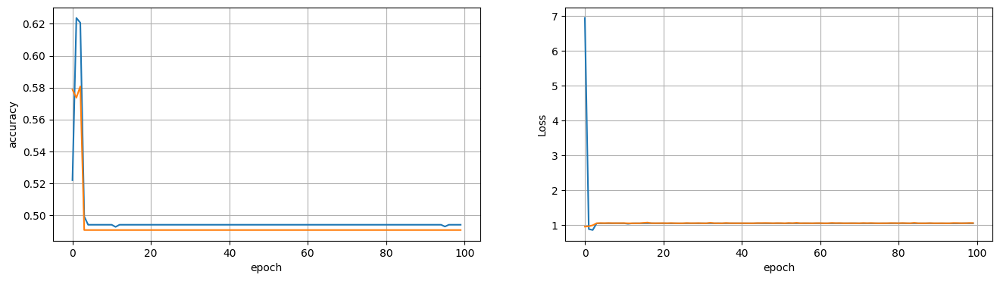

64 nodes,dropout 0,lr 0.005,batch_size 8
0.03318938612937927


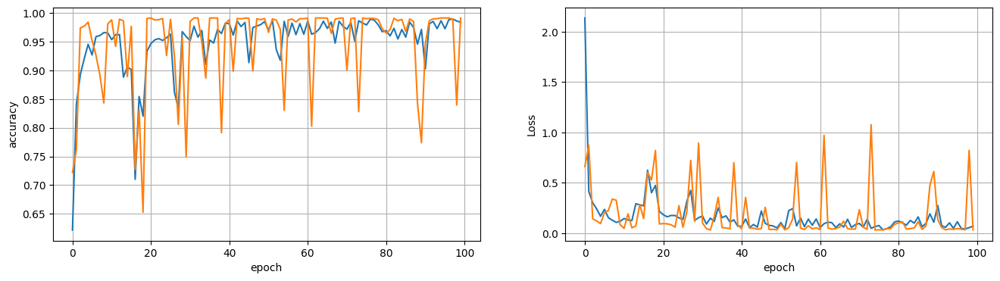

64 nodes,dropout 0,lr 0.005,batch_size 16
0.025177864357829094


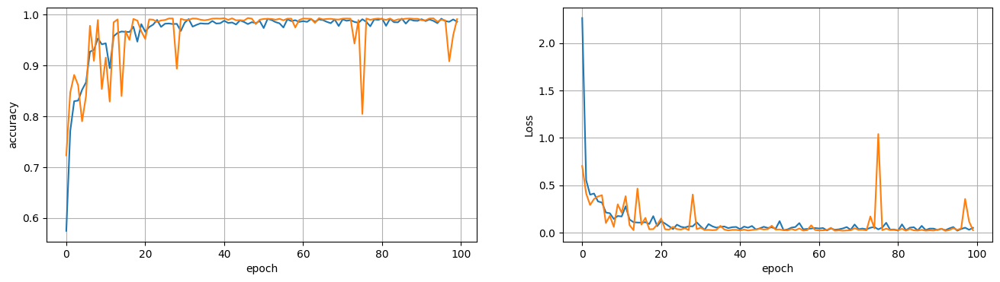

64 nodes,dropout 0,lr 0.005,batch_size 64
0.03292657807469368


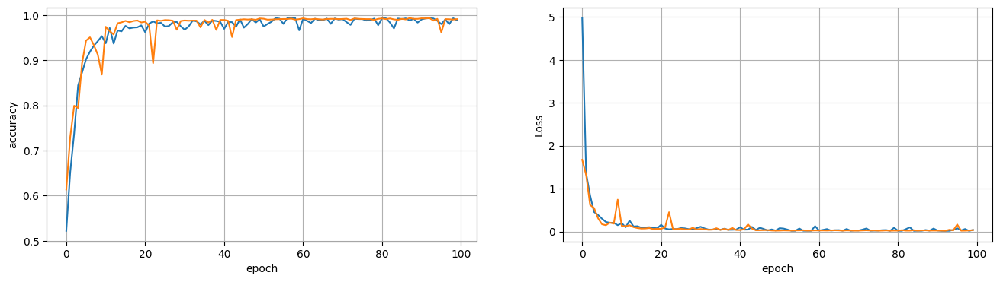

64 nodes,dropout 0,lr 0.001,batch_size 8
0.03909977152943611


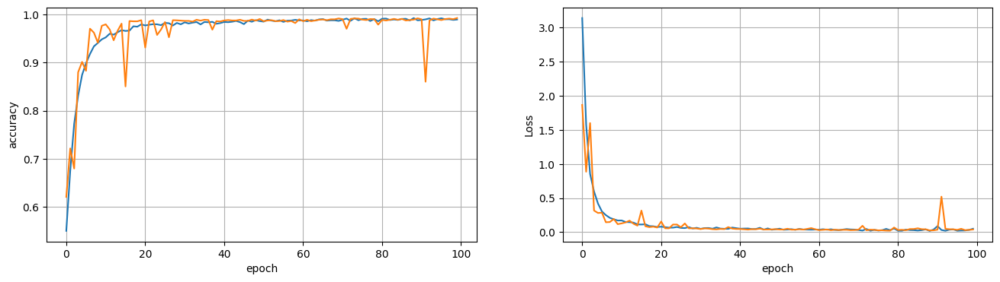

64 nodes,dropout 0,lr 0.001,batch_size 16
0.044346824288368225


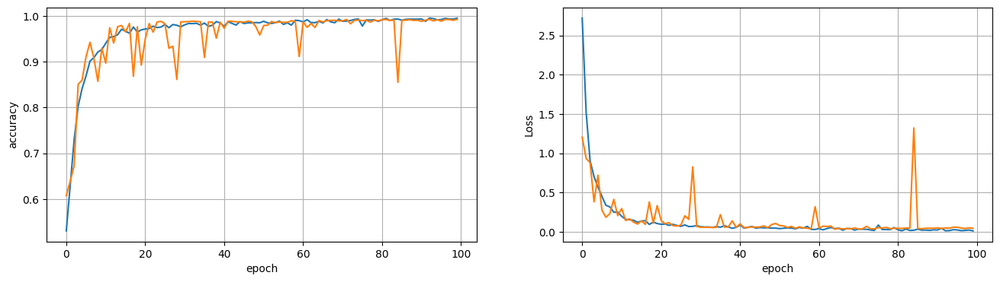

64 nodes,dropout 0,lr 0.001,batch_size 64
0.08517935872077942


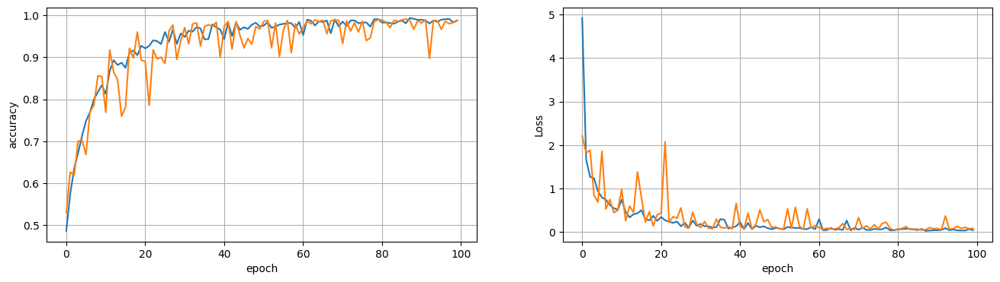

64 nodes,dropout 0.2,lr 0.1,batch_size 8
1.0477886199951172


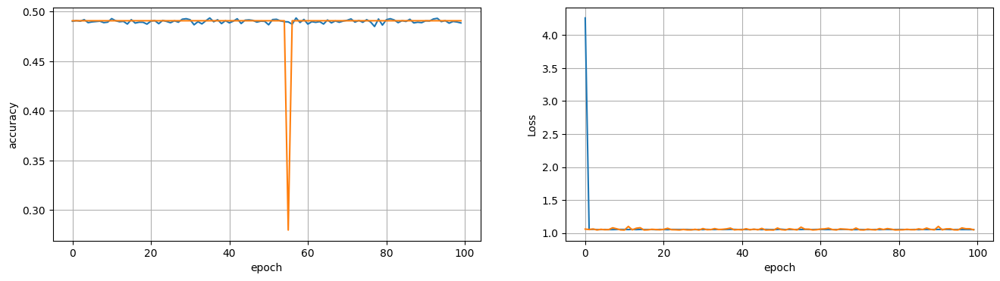

64 nodes,dropout 0.2,lr 0.1,batch_size 16
1.0448302030563354


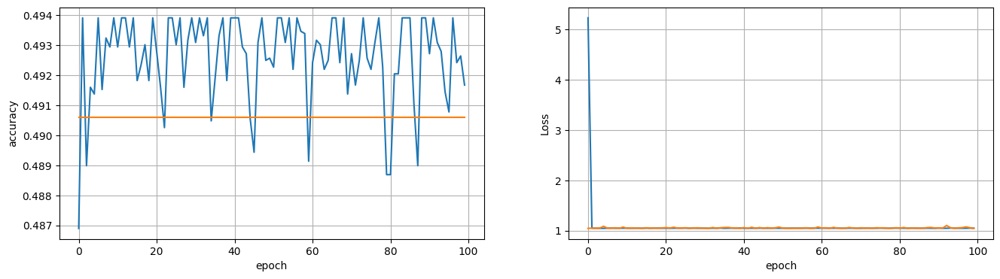

64 nodes,dropout 0.2,lr 0.1,batch_size 64
1.0521042346954346


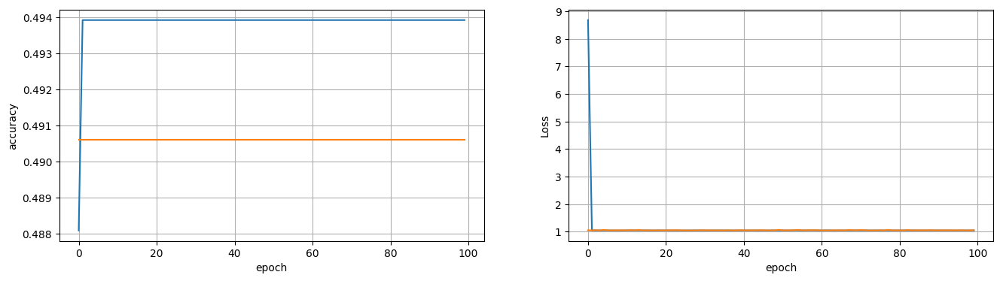

64 nodes,dropout 0.2,lr 0.005,batch_size 8
0.4676082730293274


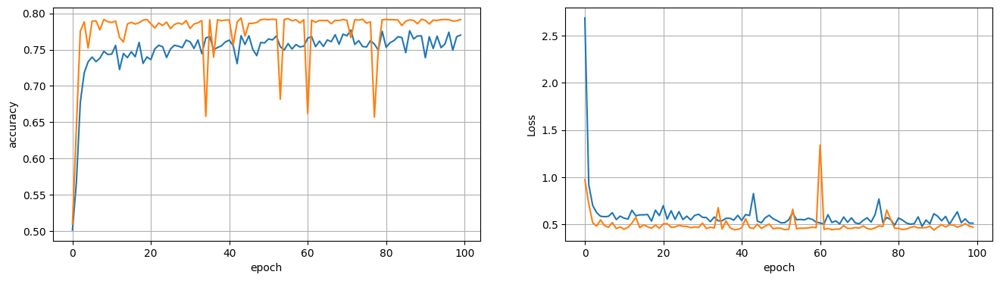

64 nodes,dropout 0.2,lr 0.005,batch_size 16
0.4417816996574402


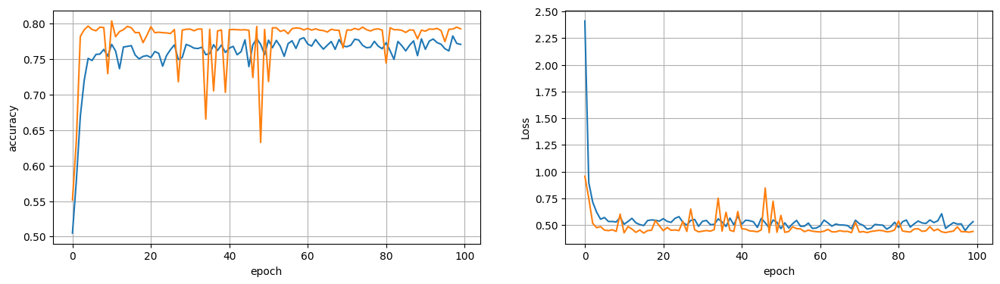

64 nodes,dropout 0.2,lr 0.005,batch_size 64
0.38729003071784973


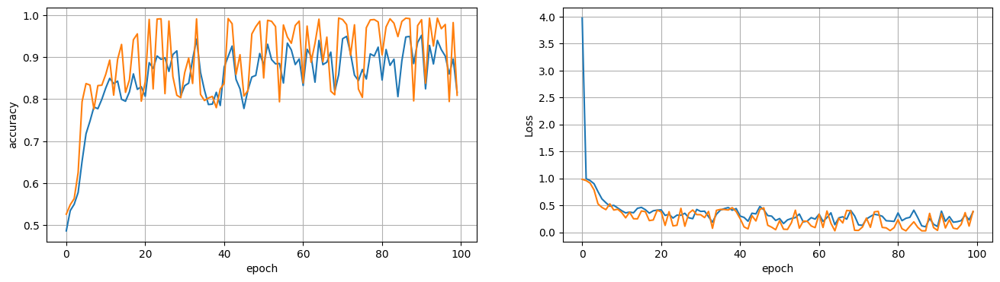

64 nodes,dropout 0.2,lr 0.001,batch_size 8
0.028711462393403053


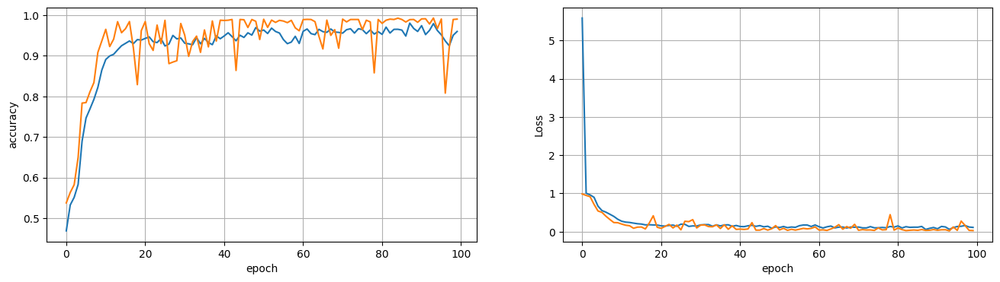

64 nodes,dropout 0.2,lr 0.001,batch_size 16
0.030497035011649132


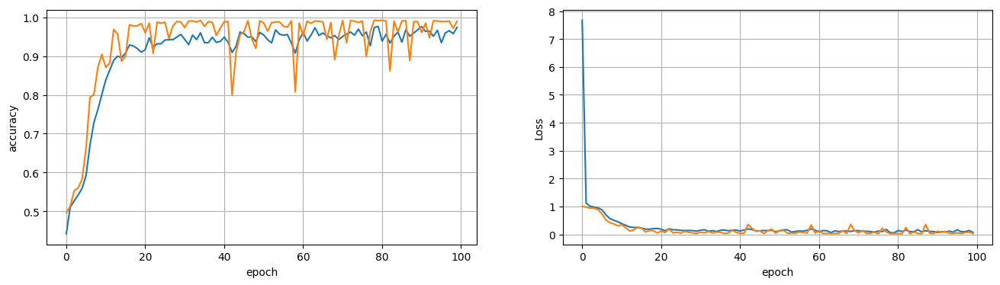

64 nodes,dropout 0.2,lr 0.001,batch_size 64
0.037857893854379654


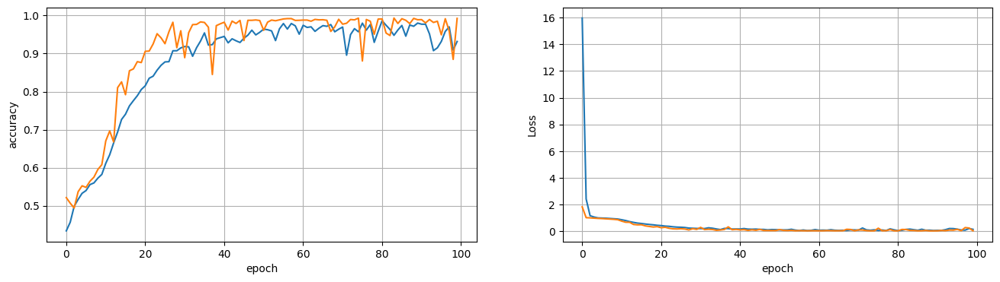

In [156]:
epochs=100
least_val_loss=float('inf')
least_loss_model=None
for num_nodes in [16,32,64]:
    for dropout_prob in[0,0.2]:
        for lr in [0.1,0.005,0.001]:
            for batch_size in [8,16,64]:
                print(f"{num_nodes} nodes,dropout {dropout_prob},lr {lr},batch_size {batch_size}")
                model,history=train_model(X_train,y_train,num_nodes,dropout_prob,lr,batch_size,epochs)
                print(history.history['val_loss'][-1])
                fig,(ax1,ax2)=plt.subplots(1,2,figsize=(16,4))
                ax1.plot(history.history['accuracy'],label='accuracy')
                ax1.plot(history.history['val_accuracy'],label='val_accuracy')
                ax1.set_ylabel('accuracy')
                ax1.set_xlabel('epoch')
                ax1.grid(True)

                ax2.plot(history.history['loss'],label='loss')
                ax2.plot(history.history['val_loss'],label='val_loss')
                ax2.set_ylabel('Loss')
                ax2.set_xlabel('epoch')
                ax2.grid(True)
                plt.show()
                if history.history['val_loss'][-1]<least_val_loss:
                    least_val_loss=history.history['val_loss'][-1]
                    least_loss_model=model

In [157]:
print(least_val_loss)
model.summary()


0.022291626781225204


Model: "sequential_92"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_276 (Dense)               │ (None, 64)             │           768 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_184 (Dropout)           │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_277 (Dense)               │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_185 (Dropout)           │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_278 (Dense)               │ (None, 3)              │           195 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,371 (60.05 KB)

 Trainable params: 5,123 (20.01 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,248 (40.04 KB)

In [158]:
least_loss_model.evaluate(X_test,y_test)

225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 795us/step - accuracy: 0.9940 - loss: 0.0114


[0.013729031197726727, 0.9927546381950378]